<a href="https://colab.research.google.com/github/rita-milani/Fetal_Health_Classification/blob/main/Fetal_Health_Classification_PyCaret.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img alt="Colaboratory logo" width="15%" src="https://raw.githubusercontent.com/carlosfab/escola-data-science/master/img/novo_logo_bg_claro.png">

#### **Data Science na Prática 3.0**


---

#**Fetal Health Classification using PyCaret**

Neonatal death is still, unfortunately, a critical problem in some regions of the world, although occurring worldwide. For a number of reasons, sometimes difficult to predict or assess, maternal and baby health are not always granted. But there are strategies to try to harness this problem, and we will work on one of them. Through Prenatal care, the adoption of some simple exams may help to predict problems to baby health. Thus, this project aims to **classify fetal health during pregnancy**, as well as evaluate risks for mother and child. For this purpose, we will use PyCaret, a low code library, which allows the performance of complex tasks with a few lines of code. 

<p>

> *I dedicate this small project to all the parents who lost their baby child, and to all the children who lost their mothers.* 

<p>

To begin with, the data was gathered by *Ayres de Campos et al. (2000) SisPorto 2.0 A Program for Automated Analysis of Cardiotocograms. J Maternal Fetal Med 5:311-318*, an article published at The Journal of Maternal-Fetal and Neonatal Medicine, and uploaded in [Kaggle](https://www.kaggle.com/datasets/andrewmvd/fetal-health-classification). I also uploaded the *.csv* file in this [repository](https://raw.githubusercontent.com/rita-milani/data_science_na_pratica/master/dataset/fetal_health.csv). My sincere gratitude to the researchers. 

The **SDGs (Sustainable Development Goals)** adopted by United Nations state members in 2015 aim to provide a **better life quality to world population** by 2030 by establishing targets to topics that range from **poverty ending to climate action**. More specifically, **SDG 3**, that tackles achieving good health and wellbeing, specifies, through **target 2, to end preventable deaths of newborns and children under 5 years old until 2030**. The target is to reach a newborn death level as low as 12 per 1000 livebirths worldwide. And as we will see below, each region has its own level, with low-income countries still above the target, and high-income ones far below. The situation as of 2020 according to [Unicef Data](https://data.unicef.org/resources/levels-and-trends-in-child-mortality/) is, as follows:

<br>
<img src = 'https://drive.google.com/uc?id=1pmo2VJMDCdBRWuWIZHMVlOOJj57KKvIK'  width=80% align='center'>

As we can see, the differences in actual death rates depend substantially in countries income levels, with the highest ones in Central and Southern Asia and Sub-Saharan Africa, while Europe and Northern America and Australia and New Zealand were already below the target since 1990. Also, the income difference reflects in different capabilities and limitations, which impact directly on policy measures to reduce child mortality. 

Determining the main reasons for newborn deaths is not a simple task because there are several reasons, some even undetected. According to the [World Health Organization (WHO)](https://www.who.int/news-room/fact-sheets/detail/newborns-reducing-mortality), some of the possible reasons are:
* Birth defects
* Pre-term births
* Intra-partum related complications, such as asphyxia or lack of breath
* Infections

Also according to the WHO, some of the strategies to reduce death rates are:
* High coverage of quality prenatal care
* Skilled care at birth
* Postnatal care for mother and baby
* Care of small and sick newborns

Inside prenatal care, **Cardiocotograms (CTGs)** are a simple and cost accessible option to assess fetal health, allowing healthcare professionals to take action in order to prevent child and maternal mortality. The equipment itself works by sending ultrasound pulses and reading its response, thus shedding light on fetal heart rate (FHR), fetal movements, uterine contractions and more. (Kaggle)

Thus, we will use the dataset provided in order to classify the risk of newborn death according to characteristics obtained by the Cardiocotogram exam by using **PyCaret** library in order to solve this **classification problem** with **as minimum code as possible**. This dataset contains 2126 records of features extracted from Cardiotocogram exams, which were then classified by three expert obstetritians into 3 classes:

**1.** Normal

**2.** Suspect

**3.** Pathological

Our task is to classify each patient into one of these three classes based on their indivdual characteristic. Let's start!






###**Import Libraries and Dataset**

In [4]:
pip install pycaret -q

In [5]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('white')
sns.set_palette(['#ff9900', '#146eb4', '#000000', '#232f3e', '#064B73', '#f2f2f2'])
%matplotlib inline

# enable PyCaret
from pycaret.utils import enable_colab
enable_colab()

from pycaret.classification import setup, compare_models, models, create_model, predict_model
from pycaret.classification import tune_model, plot_model, evaluate_model, finalize_model
from pycaret.classification import save_model, load_model

Colab mode enabled.


In [6]:
# import data
data_path = 'https://raw.githubusercontent.com/rita-milani/data_science_na_pratica/master/dataset/fetal_health.csv'
df = pd.read_csv(data_path)
df.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,histogram_width,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,2.4,64.0,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,10.4,130.0,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,13.4,130.0,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,23.0,117.0,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,19.9,117.0,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


###**Dataframe Characteristics**

Once we imported the dataset, we will explore its characteristics, like shape, variables, amount of null values and variable types. We can see that:
* the dataframe has 22 variables, including the target `fetal_health`, and 2126 entries
* there are no null values
* all variables belong to float type

**Important!** Usually, we would proceed to the second step of our analysis, which is the **Exploratory Data Analysis (EDA)**. As we will work with PyCaret library, which can perform a great amount of tasks with minimum amount of code, we will **print the EDA inside PyCaret setup**, which will output a **Pandas Profiling** with great deal of information. As the `setup()` contains the **whole pipeline for data processing and modeling**, our **next step** will be to **split the dataframe into train and test datasets**, so they can be used as input to the `setup()`.

In [7]:
# df shape
print('The dataframe has {} entries and {} variables.'.format(df.shape[0], df.shape[1]))

The dataframe has 2126 entries and 22 variables.


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

**Observation:** as we will use PyCaret also to make predictions with `predict_model()`, we have to transform our target `fetal_health` series, otherwise we will get an error. The problem is, the variable has 3 classes: 1, 2 ad 3. But by convention, it is expected that it begins by zero, so we have to replace [1,2,3] by [0,1,2]:

In [9]:
df['fetal_health'] = df['fetal_health'].map({1.0:0.0, 2.0:1.0, 3.0:2.0})
df.fetal_health.head()

0    1.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: fetal_health, dtype: float64

Now we can proceed with dataset split into train and test datasets. Notice that, **as specified**, the **test set has 10% of the entries from the original dataframe**. 

In [10]:
# split data into train and test sets
test = df.sample(frac=0.10)
train = df.drop(test.index)

test.reset_index(inplace=True, drop=True)
train.reset_index(inplace=True, drop=True)

print(train.shape)
print(test.shape)

(1913, 22)
(213, 22)


###**Getting started with PyCaret**
Now we can start with the PyCaret setup. There, we have to specify the **data** to be used (we will work with the **train dataset**, in order to **leave the test data out of the modeling**) and the name of the target variable, `fetal_health`. All the other parameters are optional. 

As we indicatd before, there is an option to print the Pandas Profiling in the setup process, in order to have an EDA. For this, we use the parameter `profile=True`. We will decide on the use of other parameters for Data Preparation based on the results of the Pandas Profiling.

In [11]:
# creating pycaret setup
clf = setup(data=train, 
            target='fetal_health',
            profile=True,
            fix_imbalance=True,
            preprocess=True,
            remove_outliers=True,
            remove_multicollinearity=True,
            normalize=True,
            silent=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=False, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[],
                                      target='fetal_health',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeri...
                ('dummy', Dummify(target='fetal_health')),
                ('fix_perfect', Remove_100(target='fetal_health')),
         

###**Exploratory Data Analysis and Data Preparation**
Above, we printed the **Pandas Profiling**, which contains the main analysis of our dataframe. As we are working with the train set for modeling purposes in PyCaret, we will have our train dataset analyzed instead of the original dataframe. Along with our **analysis**, whose aim is to **detect data patterns and abnormalities (like outliers and imbalance)**, we will also explain how to **fix them** in the **PyCaret Setup**.

Interested in Pandas Profiling details? Take a look at [this article](https://medium.com/dssimplified/1-line-code-for-data-exploration-in-python-pandas-profiling-1b401b13f14e)!



####**Overview**
We can see the basic information on the train set below: variables, observations, variable types, missing cells, duplicate rows, and so on. We will not deal with duplicate cells, so as we can see in the profiling, there are some small differences between them. 

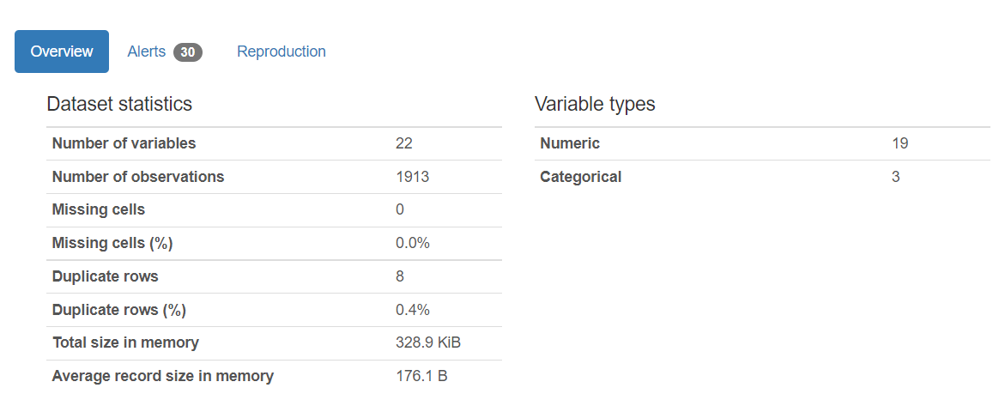



####**Missing Values**
Another possible visualization through Prandas Profiling is the Missing Values chart. This one indicates that all the observations (1913) can be found for each variable in the dataset. This is an additional way to confirm the information given in the Overview section.
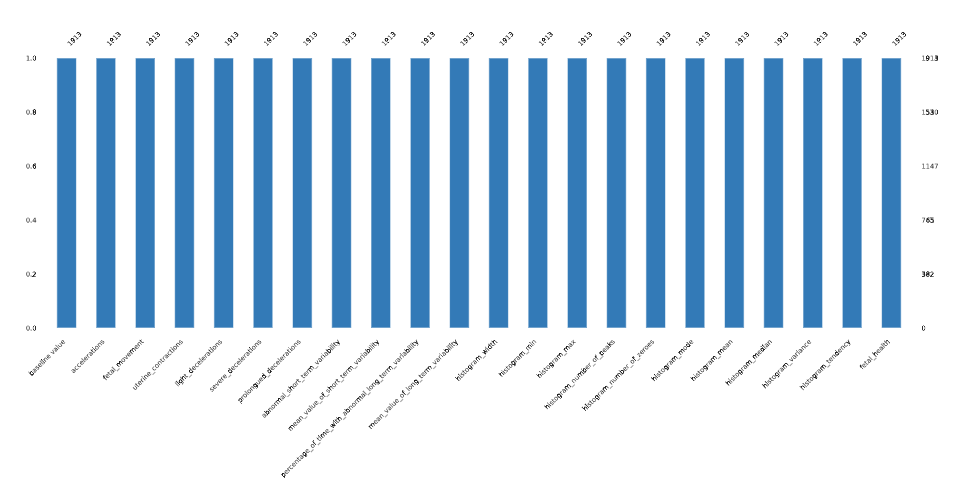

####**Correlation**
Another possible visualization is the correlation among variables through a heatmap. In our case, we can see that our target `fetal_health` has a slightly higher correlation with `abnormal_short_term_variability` and `mean_value_of_short_term_variability`. As some independent variables (features) present some degree of correlation among themselves (presence of **multicollinearity**), we will **correct the problem** by adding a parameter in the setup called `remove_multicollinearity=True`

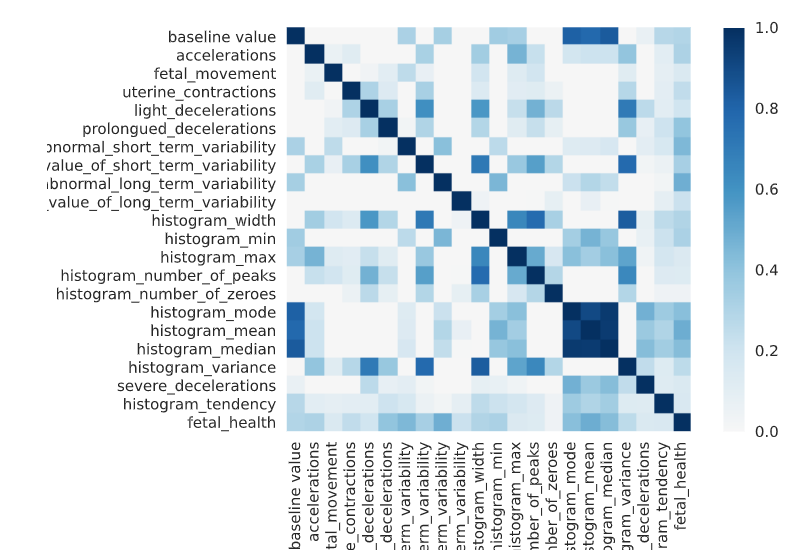

####**Variables: detecting Data Imbalance and the presence of Outliers**
**Data Imbalance**

We also have the chance to explore each variable in order to understand how they are distributed. Here, we will take a look to our target, `fetal_health`. As we can see, it is a **categoric variable** that assumes 3 possible values. And when we see their distribution, it is possible to notice that the data is **highly imbalanced**: 78.15% of the results belong to class 0. 

We will correct the imbalance by passing another parameter to the setup, `fix_imbalance=True`. Also, as we deal with another 2 categorical variables, we will pass the parameter `preprocessing=True`. 

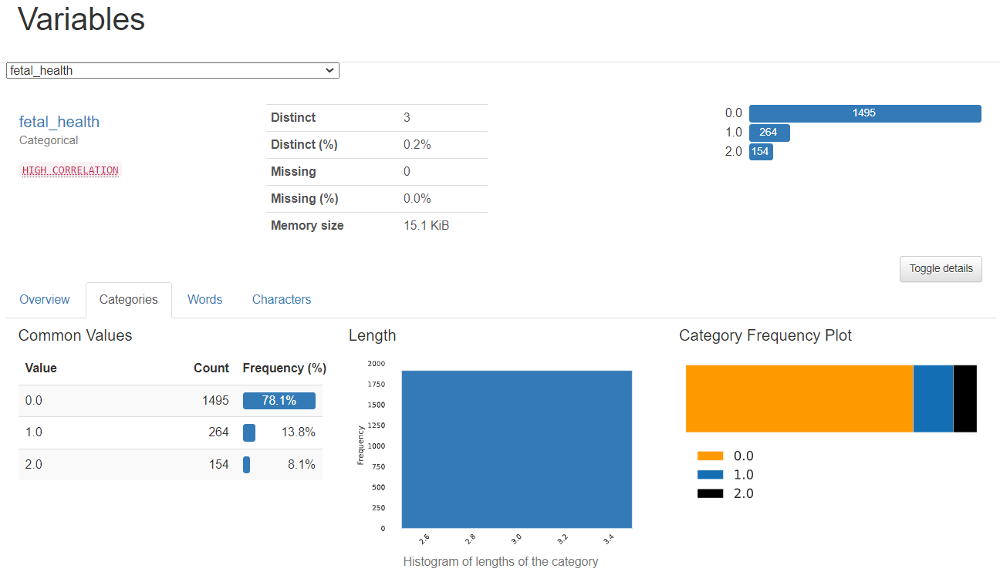


**Outliers**

By checking the Variables section, it is also possible to **detect outliers** in **numeric variables** through **descriptive statistics, histogram and share of extreme values**, as we can see below. It is possible to see in the histogram the presence of extreme low and high values, and the chart showing the share of the 10 extreme higher values. 

To correct the presence of outliers, we must pass the parameter `remove_outliers=True` in the setup process. 

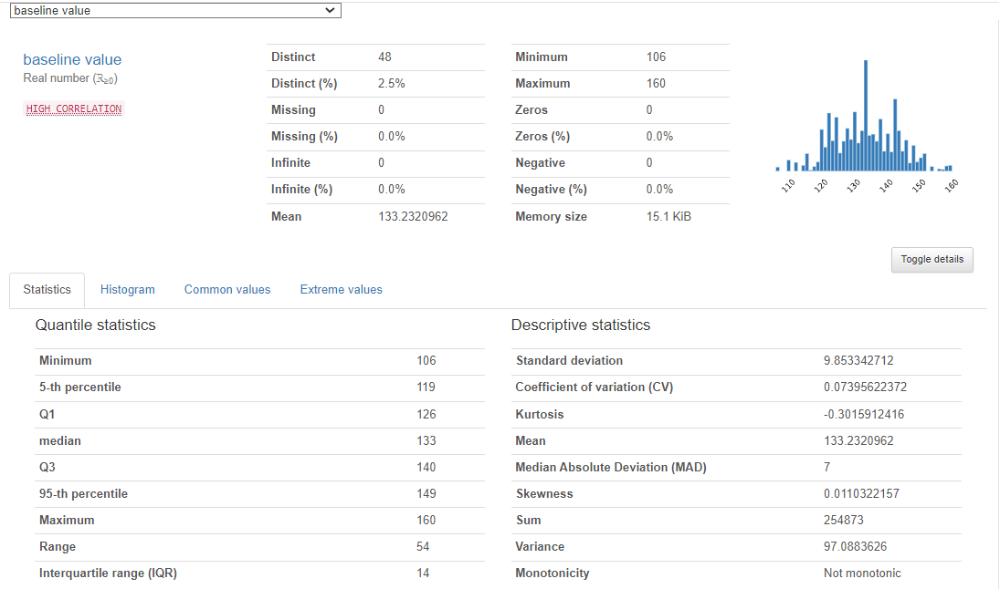

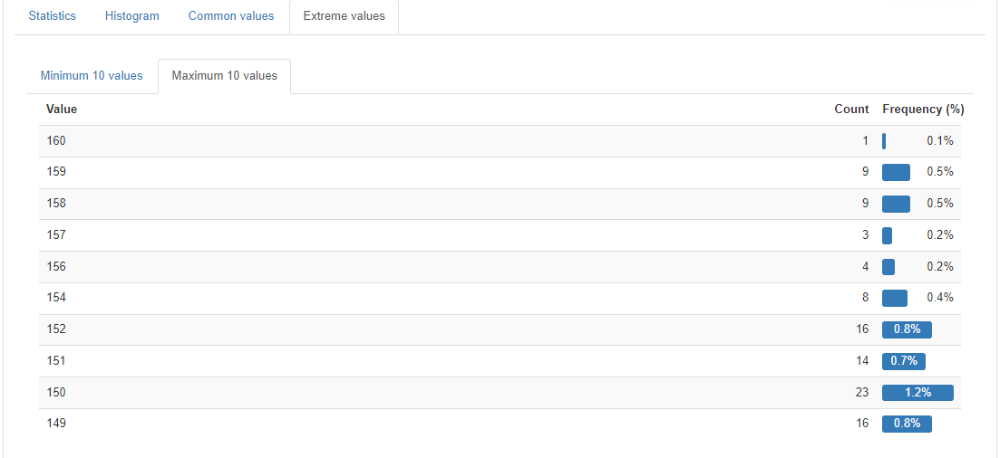

####**Normalization**
Aso inside Pandas Profiling it is possible to print a dataset sample, with the first and last entries (observations) of the dataset. Here we can observe that each variable has different ranges and variances. To correct this in order to prevent a bias during model training process, we will pass the argument `normalize=True`. 

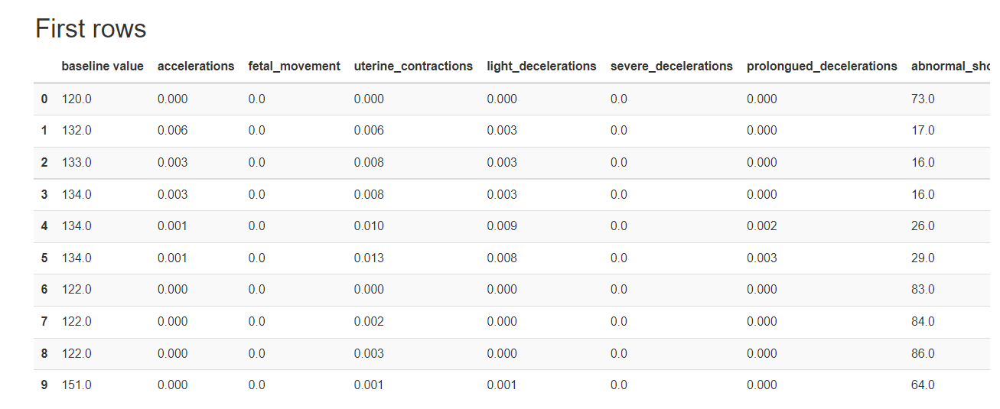

###**Machine Learning with PyCaret**
After the **EDA**, we performed the **Data Preparation** by passing the parameters described above in the `setup()` step. Now, we can go on with the model training, as we:
* removed outliers
* removed multicollinearity
* fixed data imbalance
* normalized our data

Now, using PyCaret, we want to find the model that best predicts our target variable, `fetal_health`, remembering that:
* 0: normal
* 1: suspect
* 2: pathological

When performed 'by hand', the model training phase requires many `scikit-learn` classes, like models, preprocessing tools, metrics, models and so on. If you want to test each model, unless you work with a **pipeline**, it will require a **lot of steps** and **extensive work**. What makes **PyCaret** library **powerful** is the ability to **reduce many steps into single line commands (low code)** that perform the most important tasks, like:
* analyzing data
* preprocessing data
* train several models at once
* tune the parameters
* plot evaluation charts
* make predictions
* and others.

So let's start our model training:



####**Compare Models**
For our classification problem, `compare_models()` function returned 14 different models with 6 metrics, classified by Accuracy in descending order. Everythimg with just an one line command. Then, we can work with more than one model or just with one. Here, we are choosing just one model, the **Light Gradient Boosting Machine**.

In [12]:
# compare model
best = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9442,0.9888,0.8908,0.9462,0.9438,0.8337,0.8352,0.562
gbc,Gradient Boosting Classifier,0.9410,0.9828,0.8915,0.9448,0.9415,0.8276,0.8293,3.468
rf,Random Forest Classifier,0.9402,0.9848,0.8870,0.9421,0.9400,0.8232,0.8242,0.706
et,Extra Trees Classifier,0.9395,0.9812,0.8560,0.9400,0.9384,0.8168,0.8180,0.514
dt,Decision Tree Classifier,0.9174,0.9036,0.8500,0.9243,0.9193,0.7643,0.7669,0.038
ada,Ada Boost Classifier,0.8781,0.8754,0.8223,0.8930,0.8823,0.6611,0.6665,0.252
knn,K Neighbors Classifier,0.8742,0.9451,0.8229,0.9000,0.8826,0.6691,0.6793,0.144
lr,Logistic Regression,0.8726,0.9673,0.8252,0.9017,0.8817,0.6705,0.6828,0.727
svm,SVM - Linear Kernel,0.8577,0.0000,0.8189,0.8945,0.8689,0.6395,0.6556,0.071
ridge,Ridge Classifier,0.8341,0.0000,0.8160,0.8969,0.8526,0.6081,0.6364,0.021


INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=2360, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
INFO:logs:compare_models() succesfully completed......................................


####**Create Model/ Cross Validation**
Once we chose the model, we proceed to instanciate it by using `create_model()`. At this step, the output will show the **cross validation** results performed with the training set, which is splitted into 10 folders. Then, **one folder** will be set as **test subset**, and the other **nine** as **train subsets**. The model will be trained 10 times, in such a way that **each subset will be used as a test subset at a time**. The general model Accuracy is achieved by the accuracy average of the 10 tests. Here, we get 94.4% accuracy.

In [13]:
# instanciate model
lgbm = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9688,0.9962,0.9180,0.9692,0.9684,0.9056,0.9067
1,0.9453,0.9871,0.9235,0.9489,0.9464,0.8469,0.8488
2,0.9528,0.9924,0.9194,0.9543,0.9524,0.8582,0.8589
3,0.9213,0.9755,0.8024,0.9208,0.9194,0.7499,0.7521
4,0.9685,0.9934,0.9564,0.9685,0.9685,0.9051,0.9051
5,0.9449,0.9909,0.9466,0.9485,0.9460,0.8417,0.8436
6,0.9291,0.9855,0.8389,0.9353,0.9303,0.7950,0.7960
7,0.9606,0.9946,0.8949,0.9609,0.9606,0.8866,0.8869
8,0.9213,0.9823,0.8372,0.9182,0.9187,0.7591,0.7613


INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 3
INFO:logs:LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=2360, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
INFO:logs:create_model() succesfully completed......................................


####**Tune Model**
Once we get the overall accuracy, there is another way to **improve the model accuracy** by tuning the model parameters. The first tests performed above used the default parameters. Now, there is a command line to **tune all the parameters at once**, `tune_model()`. Notice that the model **accuracy increased from 94.4% to 94.8%** by tuning the parameters. Then, we can print the tuned model to see all the parameters. 

In [14]:
tuned_lgbm = tune_model(lgbm)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9844,0.9955,0.9782,0.9852,0.9845,0.9543,0.9545
1,0.9453,0.9795,0.8930,0.9456,0.9452,0.8370,0.8373
2,0.9528,0.9930,0.9194,0.9543,0.9524,0.8582,0.8589
3,0.9134,0.9634,0.7686,0.9084,0.9091,0.7215,0.7256
4,0.9764,0.9945,0.9597,0.9761,0.9761,0.9277,0.9280
5,0.9528,0.9874,0.9346,0.9528,0.9525,0.8579,0.8581
6,0.9449,0.9860,0.8598,0.9501,0.9455,0.8406,0.8417
7,0.9685,0.9940,0.8982,0.9676,0.9677,0.9077,0.9079
8,0.9291,0.9718,0.8690,0.9295,0.9290,0.7893,0.7895


INFO:logs:create_model_container: 16
INFO:logs:master_model_container: 16
INFO:logs:display_container: 4
INFO:logs:LGBMClassifier(bagging_fraction=0.5, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.2, max_depth=-1,
               min_child_samples=100, min_child_weight=0.001, min_split_gain=0,
               n_estimators=230, n_jobs=-1, num_leaves=60, objective=None,
               random_state=2360, reg_alpha=0.2, reg_lambda=0.005,
               silent='warn', subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0)
INFO:logs:tune_model() succesfully completed......................................


In [15]:
print(tuned_lgbm)

LGBMClassifier(bagging_fraction=0.5, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.2, max_depth=-1,
               min_child_samples=100, min_child_weight=0.001, min_split_gain=0,
               n_estimators=230, n_jobs=-1, num_leaves=60, objective=None,
               random_state=2360, reg_alpha=0.2, reg_lambda=0.005,
               silent='warn', subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0)


####**Evaluate Model**
Now, we can evaluate our model by plotting some charts. There is a great amount of evaluating charts, but we will keep simple on the main ones. Again, notice the code simplicity to plot complex charts.

The first one, Feature Importance Plot, is very intersting. It shows the model's features parameters by degree of importance in the classification. Which features have the greatest influence on the classification of `fetal_health`? 

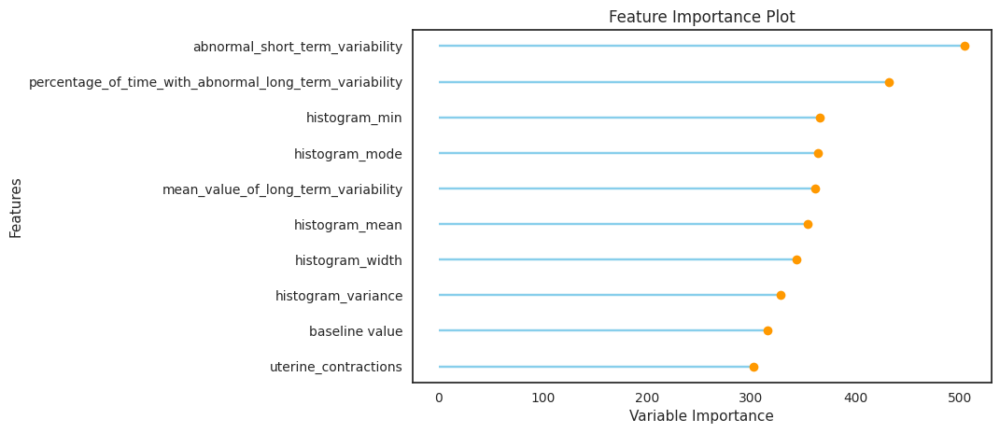

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [17]:
plot_model(tuned_lgbm, plot='feature')

Next, we plot the model's **Confusion Matrix**, again, with just one line of code. The Confusion Matrix shows the model's Predicted Class on the x-axis, and the True Class on the y-axis. We can see that:

* for normal health, the model predicts correctly 433 observations
* for suspect cases, the model predicts correctly 60 observations
* for pathological cases, the model predicts correctly 46 cases

But other measures can be obtained by this chart: 

**Precision**

From the predicted results, which share was correct?
* **normal cases:** the model  predicted (433+12+0 = 445) normal cases, but got 433 right. **Precision = 433/455 = 97.3%**
* **suspect cases:** predicted suspected: (17+60+2 = 79), but 60 right. **Precision = 60/79 = 75.9%**
* **pathological cases:** predicted pathological: (1+3+46 = 50), but got 46 right. **Precision = 46/50 = 92.0%**

**Recall**

From the true results, which share was predicted correctly?

* **normal cases:** (433+17+1 = 451) true normal cases, of which 433 were predicted correctly. **Recall = 433/451 = 96.0%**
* **suspect cases:** (12+60+3 = 75) true suspect cases, of which 60 predicted correctly. **Recall = 60/75 = 80.0%**
* **pathological cases:** (0+2+46 = 48) true pathological cases, of which 46 predicted correctly. **Recall = 46/48 = 95.8%**



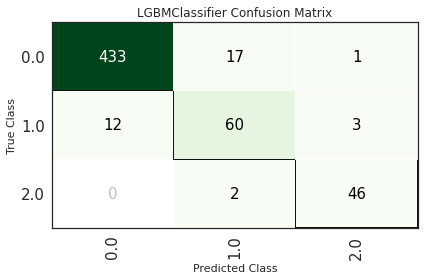

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [16]:
plot_model(tuned_lgbm, plot='confusion_matrix')

Another evaluation tool is the **ROC-AUC** curve. Basically, the **closest the indicator is to 1.0**, the **more accurate** it is in predicting the classes correctly. As we see below, we have:

* AUC = 98% for predicting class 0 (normal cases) correctly
* AUC = 97% for predicting class 1 (suspected cases) correctly
* AUC = 100% for predicting class 2 (pathological cases) correctly

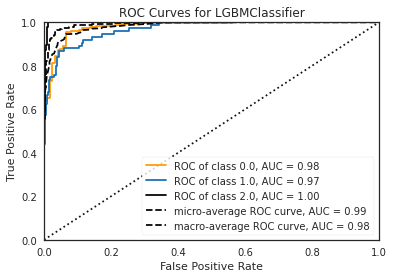

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [24]:
plot_model(tuned_lgbm, plot = 'auc')

####**Predict Model**
After evaluating the model, we can make the predictions using `predict_model()`, which will use the **train subset**. The command will print the dataset with a new column at the end, named **Label**, where the **predictions** will be printed. Also, it will be printed a new column labeled **Score**, with the **probability of each prediction**.

In [18]:
# predict model
predict_model(tuned_lgbm)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=LGBMClassifier(bagging_fraction=0.5, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.2, max_depth=-1,
               min_child_samples=100, min_child_weight=0.001, min_split_gain=0,
               n_estimators=230, n_jobs=-1, num_leaves=60, objective=None,
               random_state=2360, reg_alpha=0.2, reg_lambda=0.005,
               silent='warn', subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.939,0.9809,0.9061,0.9407,0.9397,0.8332,0.8336


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,...,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_variance,histogram_tendency,severe_decelerations_0.0,fetal_health,Label,Score
0,1.624861,1.797760,-0.198373,1.935541,0.043783,-0.265228,-1.060263,0.438510,-0.530460,-1.143581,...,0.973821,-0.488047,1.977978,1.724833,0.122343,1.109556,1.0,0.0,0,1.0000
1,-0.641589,0.744856,-0.133651,-1.479519,-0.630069,-0.265228,-0.013593,-0.259388,-0.530460,0.803205,...,-0.711735,-0.488047,-0.532936,-0.222348,-0.401147,1.109556,1.0,0.0,0,1.0000
2,1.521840,-0.834499,-0.198373,0.569517,-0.630069,-0.265228,0.219001,-0.957285,2.712104,-0.602807,...,-1.048846,-0.488047,1.413022,1.595021,-0.645443,1.109556,1.0,0.0,0,0.5807
3,-0.847630,-0.834499,-0.198373,1.594035,1.391486,1.537512,1.033077,-0.375704,-0.530460,-0.458601,...,0.636709,2.509636,-1.348983,-1.585375,-0.331348,-0.546737,1.0,0.0,0,0.9679
4,1.315799,-0.044821,-0.198373,-0.455001,0.380708,-0.265228,-0.595076,-0.026755,1.173260,-0.170188,...,-0.711735,2.509636,1.538568,1.140679,0.157243,1.109556,1.0,0.0,0,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
569,-1.877834,0.744856,-0.198373,0.911023,-0.630069,-0.265228,-1.351004,0.089561,-0.530460,0.875308,...,-1.385957,-0.488047,-1.600075,-0.936314,-0.087053,-0.546737,1.0,0.0,0,1.0000
570,0.182575,0.744856,-0.198373,-0.113495,-0.630069,-0.265228,0.626039,-0.375704,-0.530460,-0.458601,...,-0.374624,-0.488047,0.596975,0.621430,-0.436046,-0.546737,1.0,0.0,0,1.0000
571,0.800697,0.481631,0.297834,-0.796507,-0.293143,-0.265228,0.335297,-0.375704,1.008384,-0.530704,...,2.996487,-0.488047,1.036385,0.945961,-0.296449,1.109556,1.0,1.0,0,0.9663
572,-0.332528,-0.571273,-0.155225,1.252529,0.043783,-0.265228,0.335297,1.717988,-0.530460,-0.188214,...,0.299598,-0.488047,0.032019,-0.222348,-0.331348,-0.546737,1.0,0.0,0,1.0000


####**Finalize Model**
We made the prediction using the **train subset**. But now, in order to make it more accurate to use it in unseen data, we have to model it with the **train and test subsets (original train set)**. Only after this, we can use the **test set** that we split at the beginning of out project (the one with 10% of the original dataframe). The **test set** is the **unseen data**, data that was not used for modeling purpose. 

In [19]:
final_lgbm = finalize_model(tuned_lgbm)

INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LGBMClassifier(bagging_fraction=0.5, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.2, max_depth=-1,
               min_child_samples=100, min_child_weight=0.001, min_split_gain=0,
               n_estimators=230, n_jobs=-1, num_leaves=60, objective=None,
               random_state=2360, reg_alpha=0.2, reg_lambda=0.005,
               silent='warn', subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0), fit_kwargs=None, groups=None, model_only=True, display=None, experiment_custom_tags=None, return_train_score=False)
INFO:logs:Finalizing LGBMClassifier(bagging_fraction=0.5, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.2, max_depth=-1,
         

####**Predict using the Test Set**
Once we finalized the model, we can pass the original test set to make predictions and check the **true accuracy of the model in practice**. We can see that the true accuracy is **93.9% with unseen data**, a good value. We can also print the test database to compare the true results versus the predicted results, row by row. 

Additionally, we can **choose any observation from the test set and print the predicted versus the true class**, with the respective probability, as we will do below:

In [20]:
predict_test = predict_model(final_lgbm, data=test, encoded_labels=True)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=LGBMClassifier(bagging_fraction=0.5, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.2, max_depth=-1,
               min_child_samples=100, min_child_weight=0.001, min_split_gain=0,
               n_estimators=230, n_jobs=-1, num_leaves=60, objective=None,
               random_state=2360, reg_alpha=0.2, reg_lambda=0.005,
               silent='warn', subsample=1.0, subsample_for_bin=200000,
               subsample_freq=0), probability_threshold=None, encoded_labels=True, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.939,0.9826,0.9034,0.9396,0.9392,0.8488,0.8489


In [21]:
predict_test

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health,Label,Score
0,139.0,0.000,0.005,0.000,0.000,0.000,0.000,75.0,0.4,47.0,...,6.0,0.0,140.0,139.0,141.0,2.0,1.0,1.0,1,0.9999
1,144.0,0.010,0.000,0.006,0.000,0.000,0.000,38.0,0.9,0.0,...,1.0,0.0,155.0,154.0,155.0,4.0,0.0,0.0,0,0.9999
2,148.0,0.000,0.000,0.007,0.000,0.000,0.000,51.0,0.6,49.0,...,1.0,0.0,160.0,159.0,160.0,0.0,0.0,0.0,0,0.9783
3,122.0,0.000,0.000,0.005,0.003,0.000,0.000,27.0,1.2,0.0,...,3.0,2.0,120.0,120.0,123.0,4.0,1.0,0.0,0,0.9994
4,139.0,0.000,0.009,0.000,0.000,0.000,0.000,62.0,0.7,27.0,...,4.0,0.0,148.0,147.0,148.0,2.0,1.0,0.0,1,0.9997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
208,121.0,0.000,0.000,0.004,0.009,0.001,0.000,70.0,1.9,0.0,...,6.0,2.0,67.0,76.0,79.0,68.0,-1.0,2.0,2,0.9998
209,138.0,0.000,0.002,0.009,0.014,0.000,0.002,60.0,2.6,0.0,...,8.0,2.0,117.0,99.0,117.0,80.0,0.0,2.0,2,1.0000
210,145.0,0.004,0.000,0.007,0.000,0.000,0.000,55.0,0.6,8.0,...,5.0,0.0,149.0,150.0,151.0,2.0,0.0,0.0,0,0.9818
211,130.0,0.003,0.005,0.006,0.003,0.000,0.000,52.0,3.0,0.0,...,6.0,0.0,139.0,130.0,136.0,15.0,0.0,0.0,0,1.0000


In [22]:
print('Position 211,: effective: {}, prediction: {} with {:.2f}% probability.'.format(predict_test.fetal_health[211], predict_test.Label[211], predict_test.Score[211]*100))

Position 211,: effective: 0.0, prediction: 0 with 100.00% probability.


###**Conclusion**
The objective of this project was to build a model to predict fetal health. But, differently from other projects, we used this one to present the PyCaret library, whose advantage is the use of single lines of coding in order to perform complex tasks.

After presenting the problem, the occurrence of neonatal death and the United Nations SDG 3.2, which targets the reduction of passing at childbirth by 12/1000, we focused on one of the strategies to achieve it, the use of Cardiocotogram, a simple and reasonable approach to prevent neonatal death.

With over 2,000 observations and 22 varibles gathered from prenatal cardiocotogram exams in a scientific article, we analyzed this data in order to understand it and build an accurate model to predict the fetal health. Through PyCaret, we used Pandas Profiling in order to perform an Exploratory Data Analysis, which helped us to find patterns and anomalies to be corrected in PyCaret setup (data preparation). 

Then, we proceeded with the choice of the model, model tuning, model evaluation and predictions. By using PyCaret, single lines of code were enough to perform each of these steps. Surely, we are responsible for the choices and analysis, as in the Confusion Matrix, which showed the model predictions accuity, like precision and recall.

We then finalized the model and performed the prediction on a set of unknown data (data which was not used to train the model). We were able to achieve a high degree of accuracy to predict fetal health classification, developing a tool that can be very helpful for doctors to quickly take decisions regarding mother and baby health and safety. 